# Clustering

Clustering is one of the most common exploratory data analysis technique used to get an intuition about the structure of the data. It can be defined as the task of identifying subgroups in the data such that data points in the same subgroup (cluster) are very similar while data points in different clusters are very different. In other words, we try to find homogeneous subgroups within the data such that data points in each cluster are as similar as possible according to a similarity measure such as euclidean-based distance or correlation-based distance. 

Clustering analysis can be done on the basis of the features where we try to find subgroups of samples based on features or on the basis of samples where we try to find subgroups of features based on samples. Here I will use clustering based on features. 

In [1]:
import numpy as np
import pandas as pd
!pip install plotly
import plotly.graph_objects as go
from datetime import timedelta
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.decomposition import KernelPCA
from sklearn.decomposition import PCA
import plotly.figure_factory as ff

from sklearn.cluster import KMeans, SpectralClustering
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.metrics import silhouette_samples, silhouette_score

In [2]:
!pip install yellowbrick
from yellowbrick.cluster import SilhouetteVisualizer
from yellowbrick.cluster import KElbowVisualizer

In [3]:
import warnings
warnings.filterwarnings('ignore')

In [6]:
cve = pd.read_csv('cve_cleaned.csv', header=0, index_col=0)

In [7]:
cve.describe()

,cvss,cwe_code,access_authentication,access_complexity,access_vector,impact_availability,impact_confidentiality,impact_integrity
count,87613.000000,87613.000000,87613.000000,87613.000000,87613.000000,87613.000000,87613.000000,87613.000000
mean,6.014371,198.705535,0.136190,0.510027,0.916359,0.858548,0.859313,0.898725
std,1.990095,174.893554,0.343757,0.551842,0.369274,0.757287,0.711916,0.681782
min,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4.300000,79.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000
50%,5.800000,119.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000
75%,7.500000,284.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000
max,10.000000,1188.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000


In [8]:
cve.mod_date = pd.to_datetime(cve.mod_date)
cve.pub_date = pd.to_datetime(cve.pub_date)

In [9]:
def getMonth(pub_date):
    return(pub_date.strftime('%B'))
 
def getYear(pub_date):
    return(pub_date.strftime('%Y'))
 
# Applying the month and year extractor functions
cve['month']=cve['pub_date'].apply(getMonth)
cve['year']=cve['pub_date'].apply(getYear)

In [10]:
z = cve['month'].value_counts()

z1 = z.to_dict() #converts to dictionary

cve['count'] = cve['month'].map(z1)

In [11]:
months_categories = ["January", "February", "March", "April", "May", "June", "July", "August", "September", "October", "November", "December"]
cve["month"] = pd.Categorical(cve["month"], categories = months_categories)
cve = cve.sort_values(by = ["month", "year"])

In [12]:
cve.drop(['cwe_name', 'cwe_code' ,'summary', 'mod_date', 'pub_date'], axis=1, inplace=True)

In [13]:
cve = cve.astype({"year": int})

In [14]:
look_up = {'January': '1', 'February': '2', 'March': '3', 'April': '4', 'May': '5',
           'June': '6', 'July': '7', 'August': '8', 'September': '9', 
           'October': '10', 'November': '11', 'December': '12'}

cve['month'] = cve['month'].apply(lambda x: look_up[x])

In [15]:
cve = cve.astype({"month": int})

In [16]:
cve.info()

<class 'pandas.core.frame.DataFrame'>
Index: 87613 entries, CVE-1999-0349 to CVE-2018-19835
Data columns (total 10 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   cvss                    87613 non-null  float64
 1   access_authentication   87613 non-null  int64  
 2   access_complexity       87613 non-null  int64  
 3   access_vector           87613 non-null  int64  
 4   impact_availability     87613 non-null  int64  
 5   impact_confidentiality  87613 non-null  int64  
 6   impact_integrity        87613 non-null  int64  
 7   month                   87613 non-null  int64  
 8   year                    87613 non-null  int64  
 9   count                   87613 non-null  int64  
dtypes: float64(1), int64(9)
memory usage: 7.4+ MB


In [17]:
cve.head()

,cvss,access_authentication,access_complexity,access_vector,impact_availability,impact_confidentiality,impact_integrity,month,year,count
CVE-1999-0349,7.5,0,0,1,1,1,1,1,1999,6308
CVE-1999-0348,5.0,0,0,1,0,1,0,1,1999,6308
CVE-1999-0656,5.0,0,0,1,0,1,0,1,1999,6308
CVE-1999-0226,10.0,0,0,1,2,2,2,1,1999,6308
CVE-1999-0453,5.0,0,0,1,0,1,0,1,1999,6308


In [18]:
x = cve.values

In [19]:
std_scaler = StandardScaler()

In [20]:
x_scaled = std_scaler.fit_transform(x)

In [21]:
df = pd.DataFrame(x_scaled)

In [22]:
df.columns = ['cvss', 'access_authentication', 'access_complexity', 'access_vector', 'impact_availability', 'impact_confidentiality', 'impact_integrity', 'month', 'year', 'count']

In [23]:
df.head()

,cvss,access_authentication,access_complexity,access_vector,impact_availability,impact_confidentiality,impact_integrity,month,year,count
0,0.746516,-0.396183,-0.924232,0.226501,0.186788,0.197618,0.148545,-1.675827,-3.9163,-1.239969
1,-0.509713,-0.396183,-0.924232,0.226501,-1.133723,0.197618,-1.318208,-1.675827,-3.9163,-1.239969
2,-0.509713,-0.396183,-0.924232,0.226501,-1.133723,0.197618,-1.318208,-1.675827,-3.9163,-1.239969
3,2.002745,-0.396183,-0.924232,0.226501,1.507300,1.602287,1.615298,-1.675827,-3.9163,-1.239969
4,-0.509713,-0.396183,-0.924232,0.226501,-1.133723,0.197618,-1.318208,-1.675827,-3.9163,-1.239969


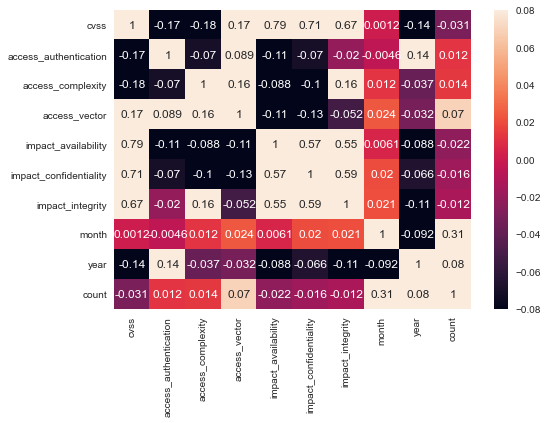

In [24]:
ax = sns.heatmap(df.cov(),vmin=-0.08, vmax=0.08, annot = True)
plt.show()

There seems to be a correlation between the `cvss` score and the different types of impacts on the CIA triad: confidentiality, integrity, availability. Other than that, there is no strong correlation between these metrics. This is due to the formula used to calculate the CVSS score, where the different types of impact largely contribute to the CVSS score.

Although the CVSS is a public standard it has few restrictions. The CVSS score calculation is subjective and two users may be having different CVSS scores. On the other hands, the users should be familiar with both, the vulnerability characteristics and CVSS scoring systems.

In [25]:
df2 = df.melt(var_name='groups', value_name='vals')

In [26]:
CSLcols = ("#FF0000", "#9A050A", "#112987", "#00A4FA", "#FF6600", "#008040", "#004EA1", "#5B0CB3", "#E50211", "#FF0000", 
           "#00519A",  "#75A315", "#E70008", "#E40000", "#C80815", "#FF3300")

#Create the palette with 'sns.color_palette()' and pass our list as an argument
CSLpalette = sns.color_palette(CSLcols)

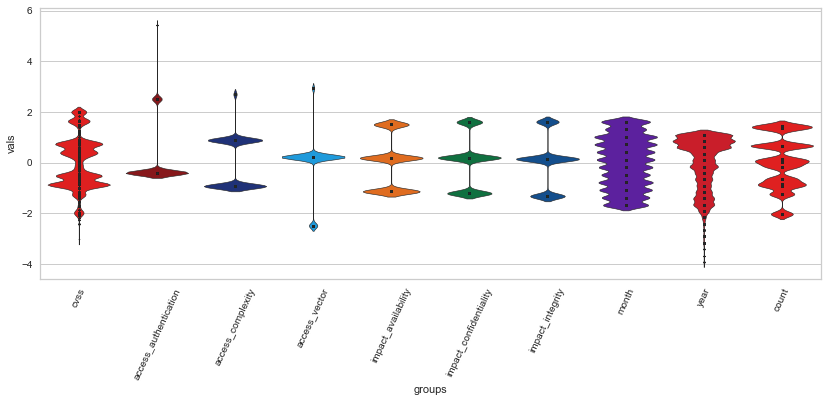

In [27]:
fig, ax = plt.subplots()
fig.set_size_inches(14, 5)

ax = sns.violinplot(x="groups", y="vals", data=df2, linewidth = 0.6, inner = 'point', scale= 'width', palette = CSLpalette)
plt.xticks(rotation=65)
plt.show()

Strangely enough, the impact features (confidentiality, integrity, availability) show very similar distribution. However, in reality this would be very unlikely: the same vulnerability will never be exploited such that the potential impacts would be similar. This is probably due to the subjective nature of the estimations, and the bias introduced in the dataset.

**kmeans** algorithm is very popular and used in a variety of applications such as market segmentation, document clustering, image segmentation and image compression, etc. 

The goal usually when we undergo a cluster analysis is either:
- Get a meaningful intuition of the structure of the data we’re dealing with.
- Cluster-then-predict where different models will be built for different subgroups if we believe there is a wide variation in the behaviors of different subgroups. An example of that is clustering patients into different subgroups and build a model for each subgroup to predict the probability of the risk of having heart attack. In this case we might want to predict the probability of a high CVSS score (and presumably also a higher financial impact if the vulnerability is exploited).

**Evaluation Methods**

Contrary to supervised learning where we have the ground truth to evaluate the model’s performance, clustering analysis doesn’t have a solid evaluation metric that we can use to evaluate the outcome of different clustering algorithms. Moreover, since kmeans requires k as an input and doesn’t learn it from data, there is no right answer in terms of the number of clusters that we should have in any problem. Sometimes domain knowledge and intuition may help but usually that is not the case. In the cluster-predict methodology, we can evaluate how well the models are performing based on different K clusters since clusters are used in the downstream modeling.
There are two commonly used metrics that may give us some intuition about k:
- Elbow method
- Silhouette analysis

**Elbow Method**

Elbow method gives us an idea on what a good k number of clusters would be based on the sum of squared distance between data points and their assigned clusters’ centroids. 

**Silhouette Analysis**

Silhouette analysis can be used to determine the degree of separation between clusters.

***
**Finding k (ideal number of clusters)**
***

In [28]:
x = cve.values #returns a numpy array
min_max_scaler = MinMaxScaler()
x_scaled2 = min_max_scaler.fit_transform(x)
df1 = pd.DataFrame(x_scaled2)

Here we try to find a cluster quality metric based on a selection of a few features. For this we can use the permutations() function to create a set of all possible combinations using only a couple of features at the same time.

In [27]:
columns = ['cvss', 'access_authentication', 'access_complexity', 'access_vector', 'impact_availability', 'impact_confidentiality', 'impact_integrity', 'month', 'year', 'count']

In [28]:
from itertools import permutations
perm = permutations(columns, 3)
output = set(map(lambda x: tuple(sorted(x)),perm))

In [29]:
column_names = ["features", "score", "elbow"]
df3 = pd.DataFrame(columns = column_names)

For each permutation we compute a cluster score using the elbow method. The elbow method is a heuristic approach used in determining the number of clusters in a data set. The method consists of plotting the explained variation as a function of the number of clusters, and picking the elbow of the curve as the number of clusters to use.

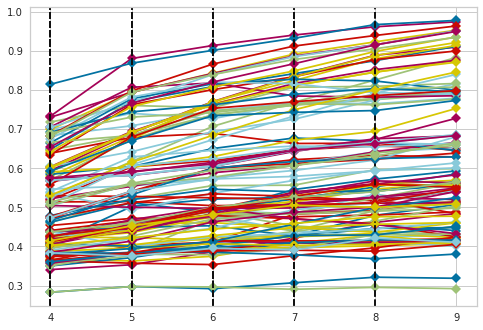

In [30]:
for i in list(output):
    df1 = df[[i[0], i[1], i[2]]]
    x = df1.values  # returns a numpy array
    min_max_scaler = MinMaxScaler()
    x_scaled = min_max_scaler.fit_transform(x)

    model = KMeans(random_state=0)
    visualizer = KElbowVisualizer(model, k=(4,10), metric='silhouette', timings=False)
    visualizer.fit(x_scaled)
    score = visualizer.elbow_score_
    value = visualizer.elbow_value_
    if score>0.7:
#         visualizer.show()
        idx = df1.columns
        mylist = idx.tolist()
        dict = {
            "features": mylist,
            "score": score,
            "elbow": value
        }
        df3 = df3.append(dict, ignore_index=True)

For each permutation we extract an elbow score and an elbow value. The score tells us how good the clustering was for this permutation, the elbow value tells us the ideal number of clusters for that permutation. Sometimes it's still hard to figure out a good number of clusters to use because the curve is monotonically decreasing and may not show any elbow or has an obvious point where the curve starts flattening out, as seems to be the case here.

The result is a pandas dataframe of feature permutations and their corresponding ideal number of clusters and the quality score of these clusters.

Once the scores are calculated for each permutation, I decided to pick the ones above >0.7 and to save them in a separate dataframe. The choice 0.7 is somewhat arbitrary, I believe a score above 0.5 is good enough, but in this particular case there seem to be a lot of such cases, so in order to reduce the size of the dataframe, I've chosen 0.7.

In [31]:
pd.set_option("display.max_colwidth", 200) 

In [32]:
df3.head(10)

,features,score,elbow
0,"[access_complexity, cvss, impact_confidentiality]",0.736349,6
1,"[impact_availability, impact_confidentiality, impact_integrity]",0.880126,5
2,"[access_vector, cvss, impact_confidentiality]",0.740028,5
3,"[access_complexity, access_vector, impact_availability]",0.764814,6
4,"[access_authentication, cvss, impact_integrity]",0.767496,7
5,"[access_vector, impact_availability, impact_integrity]",0.769766,5
6,"[access_vector, cvss, impact_availability]",0.760004,5
7,"[access_authentication, access_vector, cvss]",0.746276,6
8,"[access_vector, impact_availability, impact_confidentiality]",0.762403,5
9,"[cvss, impact_confidentiality, impact_integrity]",0.806611,5


In [29]:
# use the optimal number of clusters
kmeans = KMeans(init="k-means++",
                n_clusters=5,
                random_state=42,
                max_iter = 500).fit(x_scaled2)
df['kmeans'] = kmeans.labels_

In [39]:
c0 = df1[df1['kmeans']==0]
c1 = df1[df1['kmeans']==1]
c2 = df1[df1['kmeans']==2]
c3 = df1[df1['kmeans']==3]

In [40]:
c0.drop(['kmeans'], axis=1, inplace=True)
c1.drop(['kmeans'], axis=1, inplace=True)
c2.drop(['kmeans'], axis=1, inplace=True)
c3.drop(['kmeans'], axis=1, inplace=True)

In [43]:
x = c0.values #returns a numpy array
min_max_scaler = MinMaxScaler()
c0_scaled = min_max_scaler.fit_transform(x)
c0 = pd.DataFrame(c0_scaled)
c0.columns = ['impact_availability', 'impact_confidentiality', 'impact_integrity']
c0=c0.melt(var_name='groups', value_name='vals')

In [45]:
x = c1.values #returns a numpy array
min_max_scaler = MinMaxScaler()
c1_scaled = min_max_scaler.fit_transform(x)
c1 = pd.DataFrame(c1_scaled)
c1.columns = ['impact_availability', 'impact_confidentiality', 'impact_integrity']
c1=c1.melt(var_name='groups', value_name='vals')

In [46]:
x = c2.values #returns a numpy array
min_max_scaler = MinMaxScaler()
c2_scaled = min_max_scaler.fit_transform(x)
c2 = pd.DataFrame(c2_scaled)
c2.columns = ['impact_availability', 'impact_confidentiality', 'impact_integrity']
c2=c2.melt(var_name='groups', value_name='vals')

In [47]:
x = c3.values #returns a numpy array
min_max_scaler = MinMaxScaler()
c3_scaled = min_max_scaler.fit_transform(x)
c3 = pd.DataFrame(c3_scaled)
c3.columns = ['impact_availability', 'impact_confidentiality', 'impact_integrity']
c3=c3.melt(var_name='groups', value_name='vals')

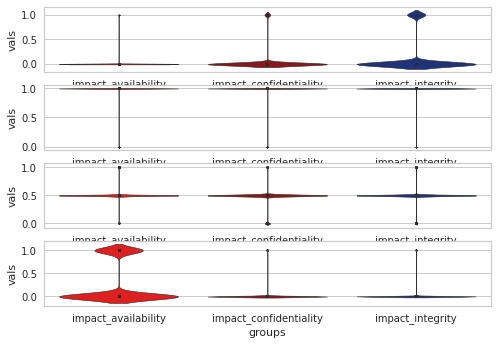

In [48]:
f, axes = plt.subplots(4, 1)
ax = sns.violinplot( data=c0 ,x="groups", y="vals", linewidth = 0.6, inner = 'point', scale= 'width', ax=axes[0], palette = CSLpalette)
ax = sns.violinplot( data=c1 ,x="groups", y="vals", linewidth = 0.6, inner = 'point', scale= 'width', ax=axes[1], palette = CSLpalette)
ax = sns.violinplot( data=c2 ,x="groups", y="vals", linewidth = 0.6, inner = 'point', scale= 'width', ax=axes[2], palette = CSLpalette)
ax = sns.violinplot( data=c3 ,x="groups", y="vals", linewidth = 0.6, inner = 'point', scale= 'width', ax=axes[3], palette = CSLpalette)

plt.show()

The feature distribution clearly shows that different impact types distributed differently across all clusters.

In [32]:
import plotly.express as px
fig = px.scatter_3d(df, x='cvss', y='impact_confidentiality', z='impact_integrity', color='kmeans')
fig.show()

In [34]:
import plotly.express as px
fig = px.scatter_3d(df, x='cvss', y='impact_availability', z='access_vector', color='kmeans')
fig.show()

In [35]:
import plotly.express as px
fig = px.scatter_3d(df, x='cvss', y='access_vector', z='access_complexity', color='kmeans')
fig.show()

The 3D scatter plot gives a different perspective showing that higher values of some features are sorted into the same cluster while the other features differentiated the remaining clusters.